# Texthero library for Text cleaning and processing

Texthero is a python package to work with text data efficiently. It empowers NLP developers with a tool to quickly understand any text-based dataset and it provides a solid pipeline to clean and represent text data, from zero to hero [Ref 1](https://texthero.org/).

Processing 'description' and 'neighboardhood_overview':

1. Cleaned by removing: html tags, stop words, punctuation, digits, etc.
2. Represented by its TF-IDF (Term Frequency-Inverse Document Frequency).
3. Transformed into two components with PCA (Principal Component Analysis.

The transfomed features are:
* description_pca_x, description_pca_y.
* neighborhood_overview_pca_x, neighborhood_overview_pca_y.


It also contains some kmens clustering to visualise some of the cloud of words in different type of properties accross London.




## Installing

In [ ]:
!pip install texthero

## Libraries


In [ ]:
# visualisation and data manipulation
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline
pd.set_option('display.max_columns', 200)


# system and files managment

import os
import sys
import pickle
import ast

# NLP
import texthero as hero
from texthero import preprocessing
from texthero import stopwords


In [ ]:
from IPython import display 

In [ ]:
# modules added to system path
path_tools = os.path.abspath(r'/tools')
sys.path.extend([path_tools])

In [ ]:
import tools.exploring_tools as mtools

## Loading data set

In [ ]:
df = pd.read_pickle('extended_data_set_pred_01.pick')

In [ ]:
df.head()

,id,description,neighborhood_overview,picture_url,host_id,host_url,host_since,host_location,host_about,host_response_time,host_response_rate,host_acceptance_rate,host_is_superhost,host_neighbourhood,host_listings_count,host_total_listings_count,host_verifications,neighbourhood,neighbourhood_cleansed,latitude,longitude,property_type,room_type,accommodates,bedrooms,beds,amenities,price,minimum_nights,maximum_nights,minimum_minimum_nights,maximum_minimum_nights,minimum_maximum_nights,maximum_maximum_nights,minimum_nights_avg_ntm,maximum_nights_avg_ntm,has_availability,availability_30,availability_60,availability_90,availability_365,number_of_reviews,number_of_reviews_ltm,number_of_reviews_l30d,first_review,last_review,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,instant_bookable,calculated_host_listings_count,calculated_host_listings_count_entire_homes,calculated_host_listings_count_private_rooms,calculated_host_listings_count_shared_rooms,reviews_per_month,bathrooms,bathrooms_shared,number_amenities,amenities_1,wifi,heating,essentials,kitchen,smoke_alarm,washer,hangers,iron,tv,hair_dryer,shampoo,dedicated_workspace,carbon_monoxide_alarm,hot_water,dryer,refrigerator,dishes_and_silverware,cooking_basics,oven,bed_linens,microwave,stove,fire_extinguisher,first_aid_kit,private_entrance,dishwasher,coffee_maker,long_term_stays_allowed,elevator,free_parking_on_premises,extra_pillows_and_blankets,lock_on_bedroom_door,host_greets_you,cable_tv,luggage_dropoff_allowed,patio_or_balcony,garden_or_backyard,breakfast,paid_parking_off_premises,lockbox,free_street_parking,bathtub,room_type_num,months_since_first_reviews,months_with_reviews,months_as_host,host_sice_YYYY,first_review_YYYY,last_review_YYYY,price_log,predicted_price_log_01,predicted_price_01
0,11551,Unlike most rental apartments out there my fla...,Not even 10 minutes by metro from Victoria Sta...,https://a0.muscache.com/pictures/b7afccf4-18e5...,43039,https://www.airbnb.com/users/show/43039,2009-10-03,"London, England, United Kingdom","Hello, I'm a friendly Italian man with a very ...",within an hour,100.0,90.0,0.0,Brixton,3.0,3.0,"['email', 'phone', 'reviews', 'jumio', 'offlin...","London, United Kingdom",Lambeth,51.46225,-0.11732,Entire apartment,Entire home/apt,4,1.0,3.0,"[""Refrigerator"", ""Kitchen"", ""Crib"", ""Dedicated...",105.0,2,1125,2.0,2.0,1125.0,1125.0,2.0,1125.0,1.0,3,33,63,338,192,6,0,2010-03-21,2020-03-26,91.0,9.0,9.0,10.0,10.0,9.0,9.0,1.0,2,2,0,0,1.46,1.0,0.0,28,"[Refrigerator, Kitchen, Crib, Dedicated worksp...",1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,1.0,1.0,1.0,0.0,1.0,1.0,1.0,1.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1,5.0,120.0,134.0,2009.0,2010.0,2020.0,4.653960,4.345627,77.140373
1,13913,My bright double bedroom with a large window h...,Finsbury Park is a friendly melting pot commun...,https://a0.muscache.com/pictures/miso/Hosting-...,54730,https://www.airbnb.com/users/show/54730,2009-11-16,"London, England, United Kingdom",I am a Multi-Media Visual Artist and Creative ...,within a few hours,100.0,75.0,0.0,LB of Islington,3.0,3.0,"['email', 'phone', 'facebook', 'reviews', 'off...","Islington, Greater London, United Kingdom",Islington,51.56802,-0.11121,Private room in apartment,Private room,2,1.0,0.0,"[""Long term stays allowed"", ""Lock on bedroom d...",40.0,1,29,1.0,1.0,29.0,29.0,1.0,29.0,1.0,30,60,90,365,21,1,0,2010-08-18,2020-02-22,97.0,10.0,10.0,10.0,10.0,9.0,9.0,0.0,2,1,1,0,0.17,1.0,1.0,41,"[Long term stays allowed, Lock on bedroom door...",1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,1.0,1.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,0.0,1.0,0.0,1.0,1.0,2,9.0,114.0,133.0,2009.0,2010.0,2020.0,3.688879,3.829633,46.045658
2,15400,Lots of windows and light. St Luke's Gardens ...,It is Chelsea.,https://a0.muscache.com/pictures/428392

In [ ]:
variables_clean = ['description',
'neighborhood_overview']

In [ ]:
df[variables_clean].head()

,description,neighborhood_overview
0,Unlike most rental apartments out there my fla...,Not even 10 minutes by metro from Victoria Sta...
1,My bright double bedroom with a large window h...,Finsbury Park is a friendly melting pot commun...
2,Lots of windows and light. St Luke's Gardens ...,It is Chelsea.
3,You'll have a wonderful stay in this superb mo...,"Location, location, location! You won't find b..."
4,Enjoy a chic stay in this elegant but fully mo...,Fulham is 'villagey' and residential – a real ...


## Cleaning 'Desrcription'

In [ ]:
# sample of text embaded in html code
df.loc[0,'description']

'Unlike most rental apartments out there my flat gives you straight away home feel mainly due to the oil paintings from my own collection, something you rarely find in 5* hotels, let alone budget accommodation! A very well equipped kitchen and a large bathroom, not to mention very fast 250 Mbps Wi-Fi and a 40 inch smart TV. <br />Very close to shops 24hrs and supermarkets providing easy reach to daily essential...not to mention just a 3-minute walk to the fastest (Victoria Line) underground in London.<br /><br /><b>The space</b><br />Amenities<br />Bedding: 1 Double bed, 1 living room with 1 chair that unfolds into a comfortable bed and 1 sofa bed for two, 1 bathroom, 1 kitchen<br />Utilities: Central heating, Wi-fi, 40inch smart TV, Kettle, Toaster, Iron board, Cooker, Fridge, Freezer, Washing machine, crockery, pots, pans, dishes etc. <br />Bed linen is provided along with fresh towels.<br /><br /><b>Guest access</b><br />Guest will have access to the entire apartment<br /><br /><b>O

In [ ]:
df.loc[1,'description']

"My bright double bedroom with a large window has a relaxed feeling! It comfortably fits one or two and is centrally located just two blocks from Finsbury Park. Enjoy great restaurants in the area and easy access to easy transport tubes, trains and buses. Babies and children of all ages are welcome.<br /><br /><b>The space</b><br />Hello Everyone,<br /><br />I'm offering my lovely double bedroom in Finsbury Park area (zone 2) for let in a shared apartment. <br />You will share the apartment with me and it is fully furnished with a self catering kitchen. Two people can easily sleep well as the room has a queen size bed. I also have a travel cot for a baby for guest with small children. <br /><br />I will require a deposit up front as a security gesture on both our parts and will be given back to you when you return the keys. <br /><br />I trust anyone who will be responding to this add would treat my home with care and respect . <br /><br />Best Wishes <br /><br />Alina<br /><br /><b>Gu

In [ ]:
custom_pipeline_1 = [preprocessing.fillna
                   , preprocessing.lowercase
                   , preprocessing.remove_digits
                   , preprocessing.remove_punctuation
                   , preprocessing.remove_diacritics
                   , preprocessing.remove_stopwords
                   , preprocessing.remove_whitespace]
                  #  , preprocessing.stem]

In [ ]:
df['desc_clean'] =  hero.clean(df['description'], pipeline=custom_pipeline_1)

In [ ]:
df.loc[0,'desc_clean']

'unlike rental apartments flat gives straight away home feel mainly due oil paintings collection something rarely find hotels let alone budget accommodation well equipped kitchen large bathroom mention fast mbps wi fi inch smart tv br close shops 24hrs supermarkets providing easy reach daily essential mention minute walk fastest victoria line underground london br br b space b br amenities br bedding double bed living room chair unfolds comfortable bed sofa bed two bathroom kitchen br utilities central heating wi fi 40inch smart tv kettle toaster iron board cooker fridge freezer washing machine crockery pots pans dishes etc br bed linen provided along fresh towels br br b guest access b br guest access entire apartment br br b ot'

In [ ]:
 # from html code
default_stopwords = stopwords.DEFAULT
# add a list of stopwords to the stopwords
custom_stopwords = default_stopwords.union(set(["'", "br", "b", 
                                                "ot", "etc", "gue",
                                                "london"]))

In [ ]:
#Call remove_stopwords and pass the custom_stopwords list
df['desc_clean'] = hero.remove_stopwords(df['desc_clean'], custom_stopwords)

In [ ]:
df.loc[0,'desc_clean']

'unlike rental apartments flat gives straight away home feel mainly due oil paintings collection something rarely find hotels let alone budget accommodation well equipped kitchen large bathroom mention fast mbps wi fi inch smart tv  close shops 24hrs supermarkets providing easy reach daily essential mention minute walk fastest victoria line underground     space   amenities  bedding double bed living room chair unfolds comfortable bed sofa bed two bathroom kitchen  utilities central heating wi fi 40inch smart tv kettle toaster iron board cooker fridge freezer washing machine crockery pots pans dishes   bed linen provided along fresh towels    guest access   guest access entire apartment    '

In [ ]:
df.loc[1,'desc_clean']

'bright double bedroom large window relaxed feeling comfortably fits one two centrally located two blocks finsbury park enjoy great restaurants area easy access easy transport tubes trains buses babies children ages welcome    space   hello everyone   offering lovely double bedroom finsbury park area zone let shared apartment  share apartment fully furnished self catering kitchen two people easily sleep well room queen size bed also travel cot baby guest small children   require deposit front security gesture parts given back return keys   trust anyone responding add would treat home care respect   best wishes   alina    '

In [ ]:
df.loc[7000,'desc_clean']

'two story well lit flat located top primrose hill park flat two bed rooms two bath rooms upstairs large living room kitchen downstairs room rent en suite bathroom access kitchen living room    space   light room big windows facing large back garden non shared toilet bathroom attached room wireless internet flat five minutes walk primrose hill park swiss cottage underground jubilee line england lane ten minutes walk chalk farm underground northern line camden town belsize park village    guest access   access large living room kitchen downstairs 60m2 otherwise used monday friday'

In [ ]:
tw = hero.visualization.top_words(df['desc_clean'])

In [ ]:
twp = tw / tw.sum() * 100

In [ ]:
twp.head(15)

room         1.630019
space        1.539375
kitchen      1.209159
flat         1.170553
bedroom      1.153580
access       1.007703
walk         0.937696
bed          0.929148
apartment    0.910405
double       0.907230
bathroom     0.777411
living       0.765485
station      0.728833
house        0.680784
minutes      0.666152
Name: desc_clean, dtype: float64

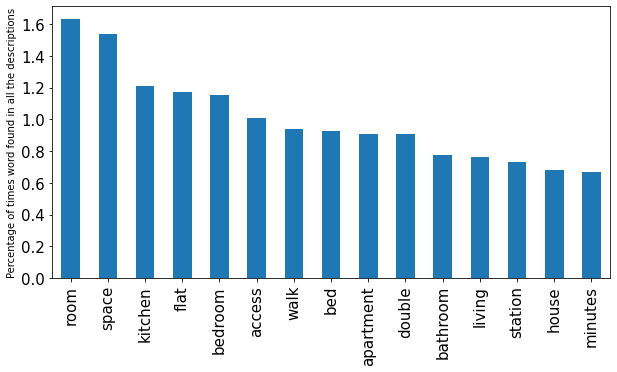

In [ ]:
mtools.bar_plot_quick(twp.head(15), figsize=(10, 5), fontsize=15, vert=True)
plt.ylabel("Percentage of times word found in all the descriptions")
None

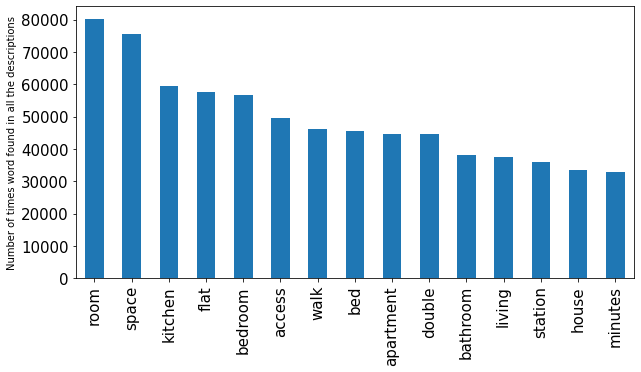

In [ ]:
mtools.bar_plot_quick(tw.head(15), figsize=(10, 5), fontsize=15, vert=True)
plt.ylabel("Number of times word found in all the descriptions")
None

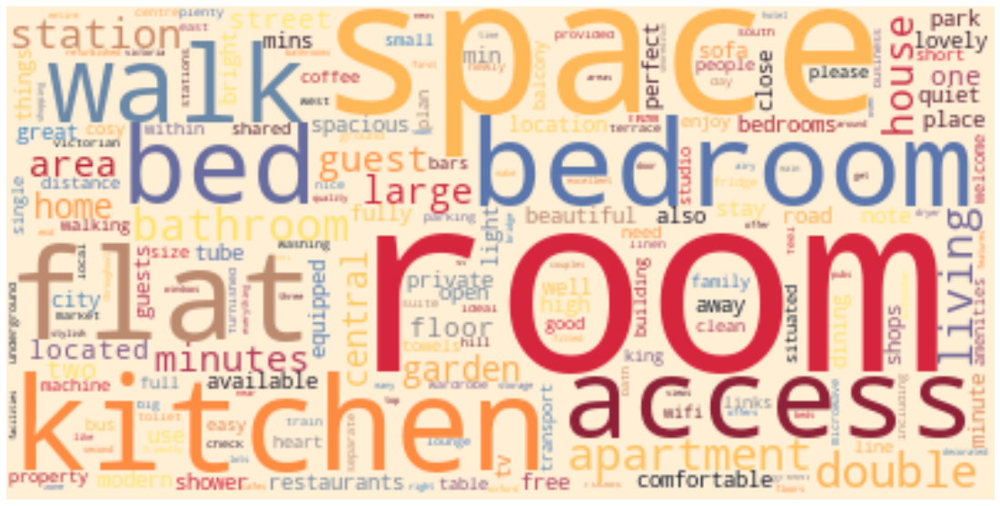

In [ ]:
tw = hero.visualization.wordcloud(df['desc_clean'])

To have a more graphical representation, it will be used the Principle Component Analysis or PCA to compress the words into vector space. But first we need to find the Term Frequency- Inverse Document Frequency that is a numerical statisc intended to reflect how important a word is to a document in a colection of documents. In this case each observation.  

The next is to run a K-means clustering to add colour to the graphical representation. Texthero takes a Series as input and Series as output so I can set the output to be a new column in the dataframe.


In [ ]:
df['desc_clean_tfidf'] = (hero.tfidf(df['desc_clean'], max_features=100))

In [ ]:
df['desc_clean_tfidf'].head()

0    [0.21304835505930939, 0.0, 0.18263644544879062...
1    [0.10209031356521026, 0.13840025713592372, 0.0...
2    [0.0, 0.0, 0.0, 0.3432769526993795, 0.0, 0.145...
3    [0.0, 0.0, 0.0, 0.4087361355600585, 0.0, 0.0, ...
4    [0.09185735741736709, 0.0, 0.0, 0.0, 0.0, 0.0,...
Name: desc_clean_tfidf, dtype: object

In [ ]:
df['desc_clean_pca'] = (df['desc_clean_tfidf'].pipe(hero.pca))

In [ ]:
df['desc_clean_kmeans_3'] = (df['desc_clean_tfidf'].pipe(hero.kmeans, n_clusters=3).astype(str))

In [ ]:
df['desc_clean_kmeans_4'] = (df['desc_clean_tfidf'].pipe(hero.kmeans, n_clusters=4).astype(str))

In [ ]:
df['desc_clean_kmeans_5'] = (df['desc_clean_tfidf'].pipe(hero.kmeans, n_clusters=5).astype(str))

In [ ]:
df['desc_clean_kmeans_6'] = (df['desc_clean_tfidf'].pipe(hero.kmeans, n_clusters=5).astype(str))

In [ ]:
df['desc_clean_kmeans_7'] = (df['desc_clean_tfidf'].pipe(hero.kmeans, n_clusters=7).astype(str))

In [ ]:
df.head()

,id,description,neighborhood_overview,picture_url,host_id,host_url,host_since,host_location,host_about,host_response_time,host_response_rate,host_acceptance_rate,host_is_superhost,host_neighbourhood,host_listings_count,host_total_listings_count,host_verifications,neighbourhood,neighbourhood_cleansed,latitude,longitude,property_type,room_type,accommodates,bedrooms,beds,amenities,price,minimum_nights,maximum_nights,minimum_minimum_nights,maximum_minimum_nights,minimum_maximum_nights,maximum_maximum_nights,minimum_nights_avg_ntm,maximum_nights_avg_ntm,has_availability,availability_30,availability_60,availability_90,availability_365,number_of_reviews,number_of_reviews_ltm,number_of_reviews_l30d,first_review,last_review,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,instant_bookable,calculated_host_listings_count,calculated_host_listings_count_entire_homes,calculated_host_listings_count_private_rooms,calculated_host_listings_count_shared_rooms,reviews_per_month,bathrooms,bathrooms_shared,number_amenities,amenities_1,wifi,heating,essentials,kitchen,smoke_alarm,washer,hangers,iron,tv,hair_dryer,shampoo,dedicated_workspace,carbon_monoxide_alarm,hot_water,dryer,refrigerator,dishes_and_silverware,cooking_basics,oven,bed_linens,microwave,stove,fire_extinguisher,first_aid_kit,private_entrance,dishwasher,coffee_maker,long_term_stays_allowed,elevator,free_parking_on_premises,extra_pillows_and_blankets,lock_on_bedroom_door,host_greets_you,cable_tv,luggage_dropoff_allowed,patio_or_balcony,garden_or_backyard,breakfast,paid_parking_off_premises,lockbox,free_street_parking,bathtub,room_type_num,months_since_first_reviews,months_with_reviews,months_as_host,host_sice_YYYY,first_review_YYYY,last_review_YYYY,price_log,predicted_price_log_01,predicted_price_01,desc_clean,desc_clean_tfidf,desc_clean_pca,desc_clean_kmeans_5,desc_clean_kmeans_7,desc_clean_kmeans_4,desc_clean_kmeans_3,desc_clean_kmeans_6
0,11551,Unlike most rental apartments out there my fla...,Not even 10 minutes by metro from Victoria Sta...,https://a0.muscache.com/pictures/b7afccf4-18e5...,43039,https://www.airbnb.com/users/show/43039,2009-10-03,"London, England, United Kingdom","Hello, I'm a friendly Italian man with a very ...",within an hour,100.0,90.0,0.0,Brixton,3.0,3.0,"['email', 'phone', 'reviews', 'jumio', 'offlin...","London, United Kingdom",Lambeth,51.46225,-0.11732,Entire apartment,Entire home/apt,4,1.0,3.0,"[""Refrigerator"", ""Kitchen"", ""Crib"", ""Dedicated...",105.0,2,1125,2.0,2.0,1125.0,1125.0,2.0,1125.0,1.0,3,33,63,338,192,6,0,2010-03-21,2020-03-26,91.0,9.0,9.0,10.0,10.0,9.0,9.0,1.0,2,2,0,0,1.46,1.0,0.0,28,"[Refrigerator, Kitchen, Crib, Dedicated worksp...",1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,1.0,1.0,1.0,0.0,1.0,1.0,1.0,1.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1,5.0,120.0,134.0,2009.0,2010.0,2020.0,4.653960,4.345627,77.140373,unlike rental apartments flat gives straight a...,"[0.21304835505930939, 0.0, 0.18263644544879062...","[-0.2070604982596298, -0.0718572616076508]",2,3,1,0,3
1,13913,My bright double bedroom with a large window h...,Finsbury Park is a friendly melting pot commun...,https://a0.muscache.com/pictures/miso/Hosting-...,54730,https://www.airbnb.com/users/show/54730,2009-11-16,"London, England, United Kingdom",I am a Multi-Media Visual Artist and Creative ...,within a few hours,100.0,75.0,0.0,LB of Islington,3.0,3.0,"['email', 'phone', 'facebook', 'reviews', 'off...","Islington, Greater London, United Kingdom",Islington,51.56802,-0.11121,Private room in apartment,Private room,2,1.0,0.0,"[""Long term stays allowed"", ""Lock on bedroom d...",40.0,1,29,1.0,1.0,29.0,29.0,1.0,29.0,1.0,30,60,90,365,21,1,0,2010-08-18,2020-02-22,97.0,10.0,10.0,10.0,10.0,9.0,9.0,0.0,2,1,1,0,0.17,1.0,1.0,41,"[Long term stays allowed, Lock on bedroom door...",1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.

In [ ]:
hero.scatterplot(df, 'desc_clean_pca', color='desc_clean_kmeans_3', title="3 Clusters of Airbnb Descriptions")

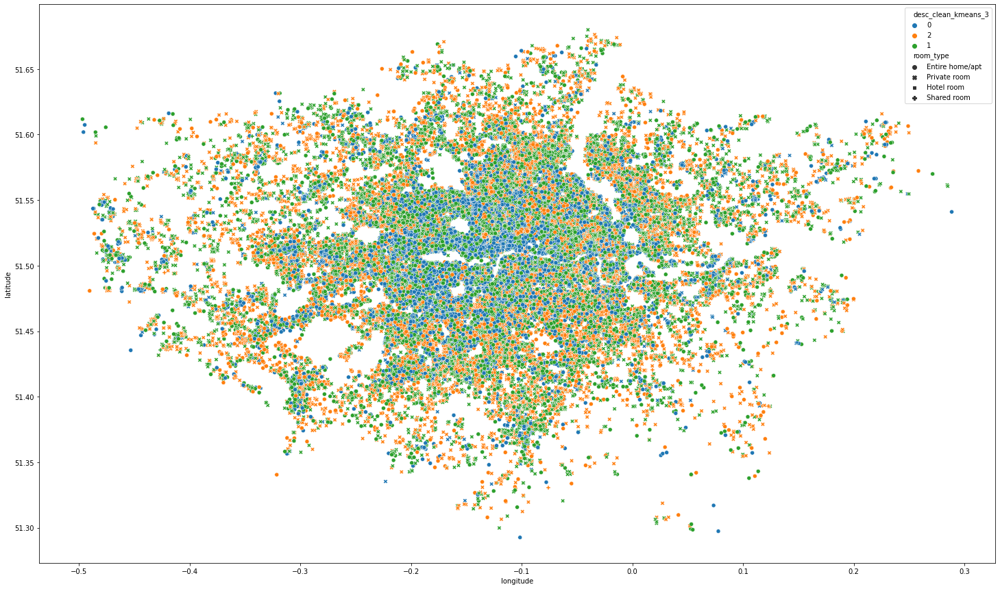

In [ ]:
fig, ax = plt.subplots(figsize=(25, 15))
sns.scatterplot(data=df, x="longitude", 
                y="latitude", 
                hue="desc_clean_kmeans_3", 
                style="room_type",
                ax=ax)

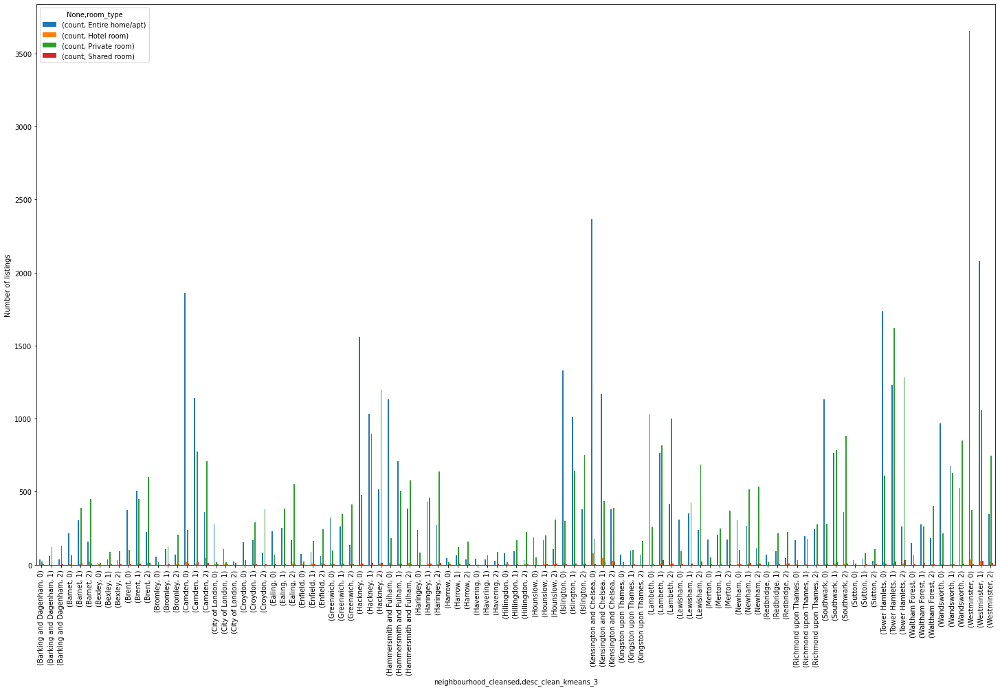

In [ ]:
df_clust_3_details = df.groupby(['neighbourhood_cleansed', 'desc_clean_kmeans_3', 'room_type'])['desc_clean_kmeans_3'].count().to_frame('count')
fig, ax = plt.subplots(figsize=(25, 15))
df_clust_3_details.unstack().plot(kind='bar', ax=ax)
plt.ylabel('Number of listings')
plt.xticks(rotation=90)
None

In [ ]:
df_clust_3_details_02 = df.groupby(['desc_clean_kmeans_3', 'room_type'])['desc_clean_kmeans_3'].count().to_frame('count')

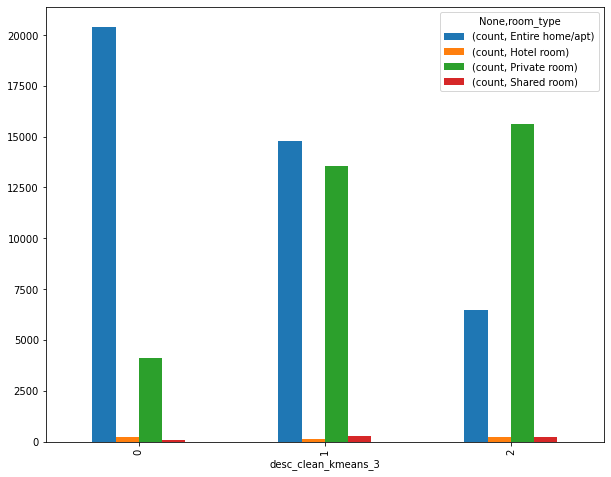

In [ ]:
fig, ax = plt.subplots(figsize=(10, 8))
df_clust_3_details_02.unstack().plot(kind='bar', ax=ax)
plt.xticks(rotation=90)
None

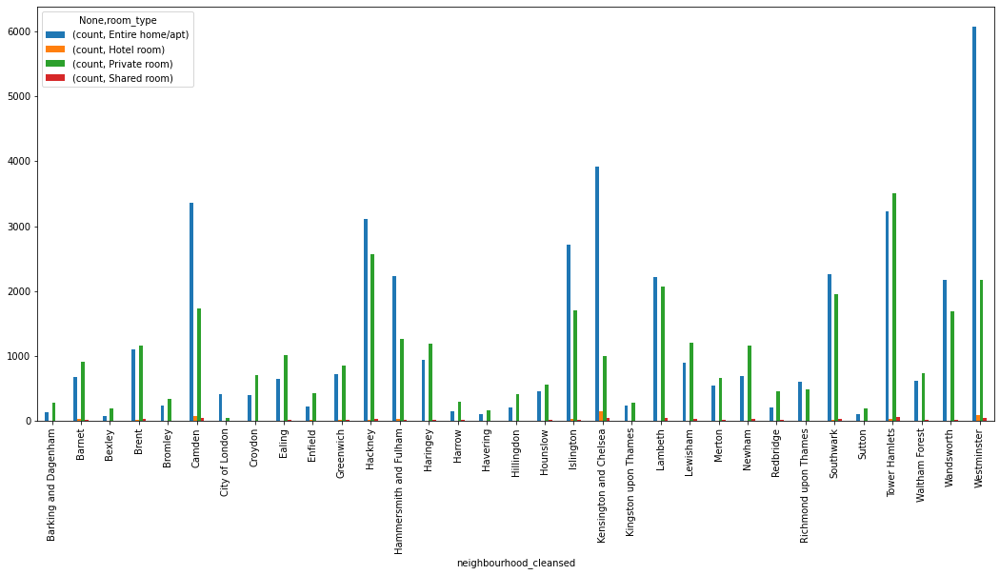

In [ ]:
fig, ax = plt.subplots(figsize=(18, 8))
df.groupby(['neighbourhood_cleansed', 'room_type'])['desc_clean_kmeans_3'].count().to_frame('count').unstack().plot(kind='bar', ax=ax)
plt.xticks(rotation=90)
None

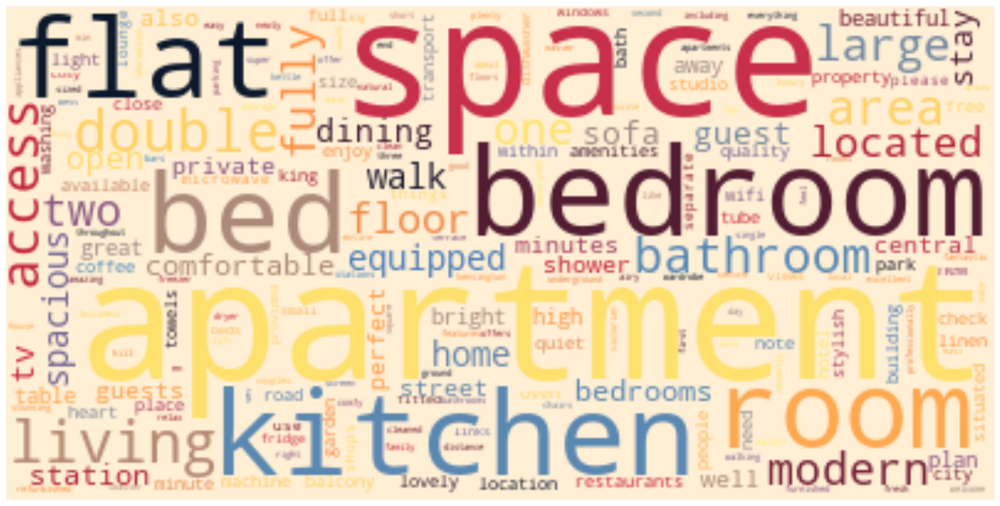

In [ ]:
tw_3_0 = hero.visualization.wordcloud(df.loc[df['desc_clean_kmeans_3'].isin(['0']), 'desc_clean'])

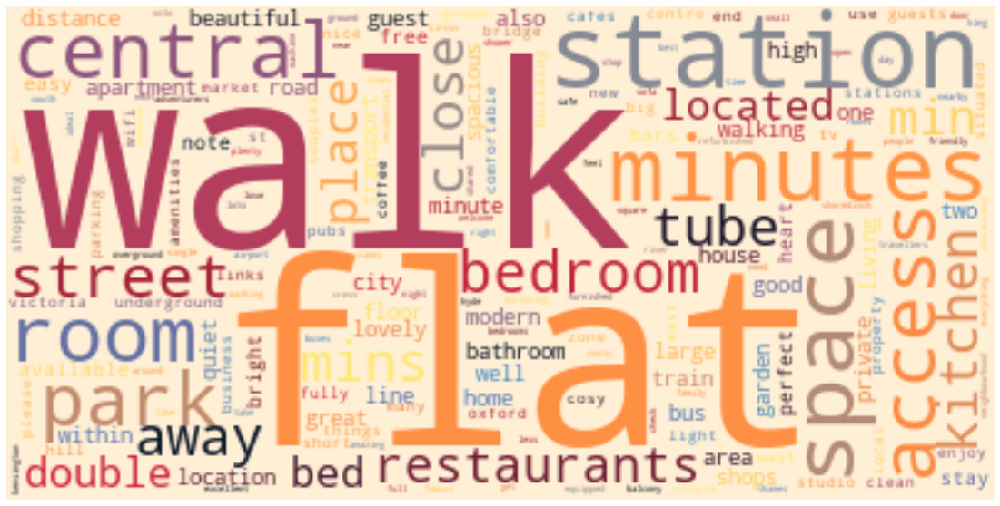

In [ ]:
tw_3_1 = hero.visualization.wordcloud(df.loc[df['desc_clean_kmeans_3'].isin(['1']), 'desc_clean'])

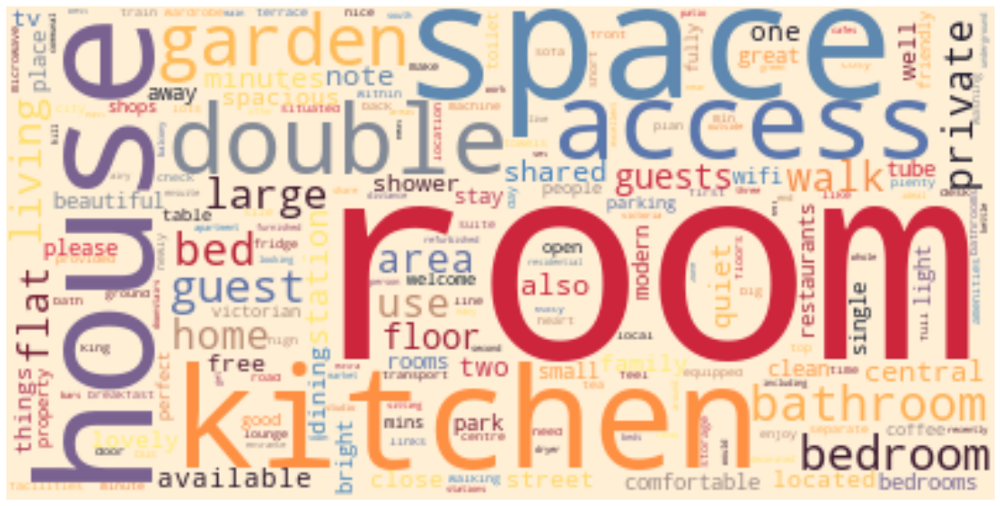

In [ ]:
tw_3_2 = hero.visualization.wordcloud(df.loc[df['desc_clean_kmeans_3'].isin(['2']), 'desc_clean'])

In [ ]:
hero.scatterplot(df, 'desc_clean_pca', color='desc_clean_kmeans_4', title="4 Clusters of Airbnb Descriptions")

In [ ]:
hero.scatterplot(df, 'desc_clean_pca', color='desc_clean_kmeans_5', title="5 Clusters of Airbnb Descriptions")

In [ ]:
hero.scatterplot(df, 'desc_clean_pca', color='desc_clean_kmeans_6', title="6 Clusters of Airbnb Descriptions")

In [ ]:
hero.scatterplot(df, 'desc_clean_pca', color='desc_clean_kmeans_7', title="5 Clusters of Airbnb Descriptions")

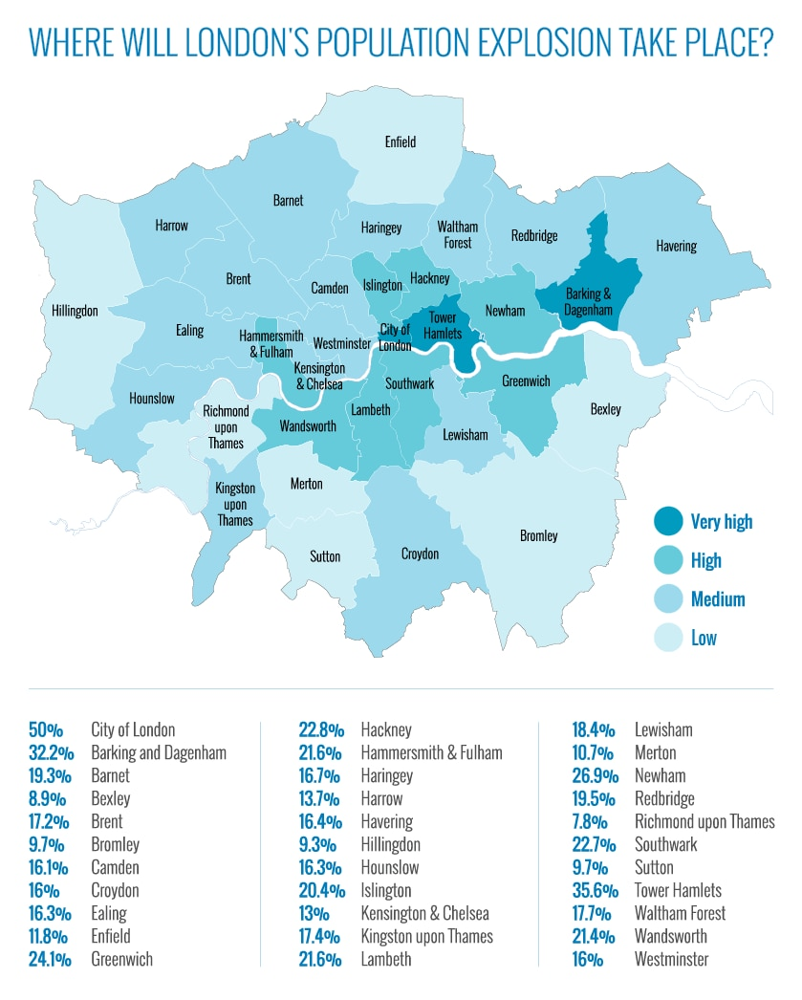

In [ ]:
display.Image("https://www.cityam.com/assets/uploads/content/2016/09/150203-london-boroughs-57edad1271160.png")

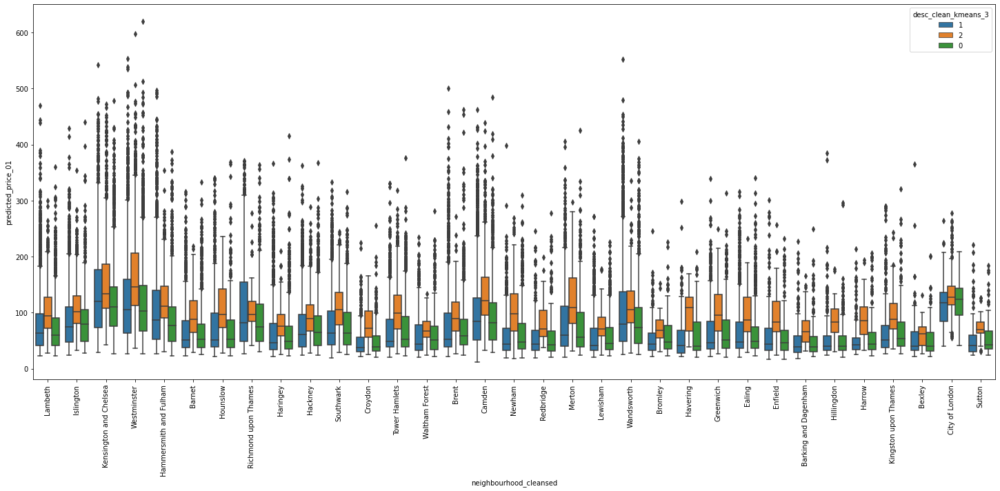

In [ ]:
fig, ax = plt.subplots(figsize=(25, 10))
sns.boxplot(x="neighbourhood_cleansed", y="predicted_price_01", hue='desc_clean_kmeans_3', data=df)
plt.xticks(rotation=90)
None

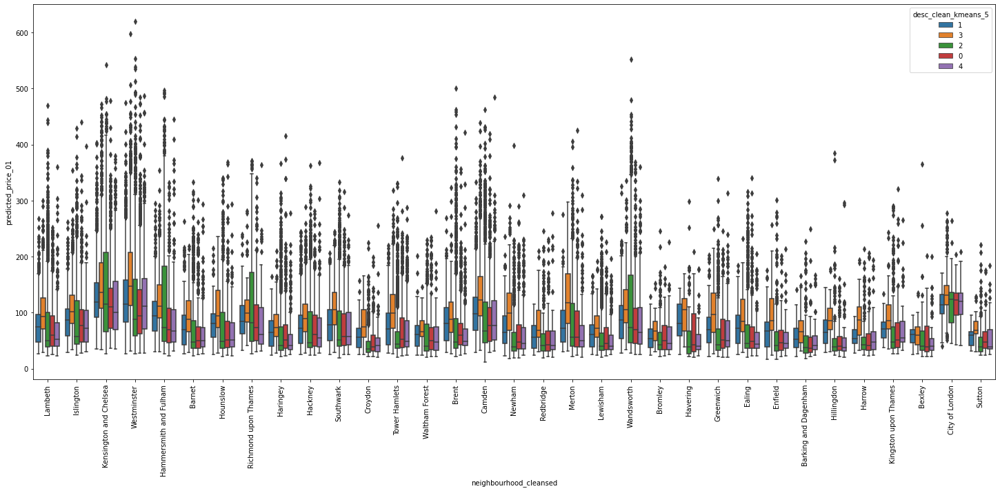

In [ ]:
fig, ax = plt.subplots(figsize=(25, 10))
sns.boxplot(x="neighbourhood_cleansed", y="predicted_price_01", hue='desc_clean_kmeans_5', data=df)
plt.xticks(rotation=90)
None

In [ ]:
# PCA representation of description
df['desccription_pca_x'] = df['desc_clean_pca'].apply(lambda x: x[0])
df['desccription_pca_y'] = df['desc_clean_pca'].apply(lambda x: x[1]) 

## Cleaning 'Neighboardhood_overview'

In [ ]:
df.loc[0,'neighborhood_overview']

'Not even 10 minutes by metro from Victoria Station there is a community where colours, sounds, flavours make you catapult into a completely new and exotic world. This is precisely the largest Afro-Caribbean London community. As soon as you immerse yourself in the local markets and in the heart of the community to the rhythm of the reggae music that resounds from the locals, you can only understand the artistic, creative and cultural uniqueness. Not surprisingly, people like Bob Marley, David Bowie, Van Gogh, Charlie Chaplin have lived in this area. But what makes Brixton so unique and unexpected? <br />Surely the first thing you notice is the huge amount of local markets and shops. From super-coloured fabrics, fruit and vegetable stand, to the largest selection of butchers and fishmongers you can find in the area, to numerous wig and hairdresser shops, the Brixton markets offer a wide selection of local and Caribbean products. From Brixton Station Road, to the famous Electric Avenue, 

In [ ]:
df.loc[1,'neighborhood_overview']

'Finsbury Park is a friendly melting pot community composed of Turkish, French, Spanish, Middle Eastern, Irish and English families. <br />We have a wonderful variety of international restaurants directly under us on Stroud Green Road. And there are many shops and large Tescos supermarket right next door. <br /><br />But you can also venture up to Crouch End and along Greens Lanes where there will endless choice of Turkish and Middle Eastern cuisines.s'

In [ ]:
df['neigh_clean'] =  hero.clean(df['neighborhood_overview'], pipeline=custom_pipeline_1)

In [ ]:
df.loc[0,'neigh_clean']

'even minutes metro victoria station community colours sounds flavours make catapult completely new exotic world precisely largest afro caribbean london community soon immerse local markets heart community rhythm reggae music resounds locals understand artistic creative cultural uniqueness surprisingly people like bob marley david bowie van gogh charlie chaplin lived area makes brixton unique unexpected br surely first thing notice huge amount local markets shops super coloured fabrics fruit vegetable stand largest selection butchers fishmongers find area numerous wig hairdresser shops brixton markets offer wide selection local caribbean products brixton station road famous electric avenue'

In [ ]:
 # from html code
default_stopwords = stopwords.DEFAULT
# add a list of stopwords to the stopwords
custom_stopwords = default_stopwords.union(set(["'", "br", "b", 
                                                "ot", "etc", "gue",
                                                "london", "also", "road", 
                                                "great", "street", "away"]))

In [ ]:
#Call remove_stopwords and pass the custom_stopwords list
df['neigh_clean'] = hero.remove_stopwords(df['neigh_clean'], custom_stopwords)

In [ ]:
df.loc[0,'neigh_clean']

'even minutes metro victoria station community colours sounds flavours make catapult completely new exotic world precisely largest afro caribbean  community soon immerse local markets heart community rhythm reggae music resounds locals understand artistic creative cultural uniqueness surprisingly people like bob marley david bowie van gogh charlie chaplin lived area makes brixton unique unexpected  surely first thing notice huge amount local markets shops super coloured fabrics fruit vegetable stand largest selection butchers fishmongers find area numerous wig hairdresser shops brixton markets offer wide selection local caribbean products brixton station road famous electric avenue'

In [ ]:
df.loc[1,'neigh_clean']

'finsbury park friendly melting pot community composed turkish french spanish middle eastern irish english families  wonderful variety international restaurants directly us stroud green road many shops large tescos supermarket right next door   also venture crouch end along greens lanes endless choice turkish middle eastern cuisines'

In [ ]:
df.loc[7000,'neigh_clean']

''

In [ ]:
tw = hero.visualization.top_words(df['neigh_clean'])

In [ ]:
twp = tw / tw.sum() * 100

In [ ]:
twp.head(15)

walk           1.809460
restaurants    1.403884
park           1.293960
area           1.071078
minutes        1.067825
shops          1.037781
market         0.699020
bars           0.679340
minute         0.585953
pubs           0.580496
close          0.574487
local          0.572116
cafes          0.564178
within         0.557893
station        0.546978
Name: neigh_clean, dtype: float64

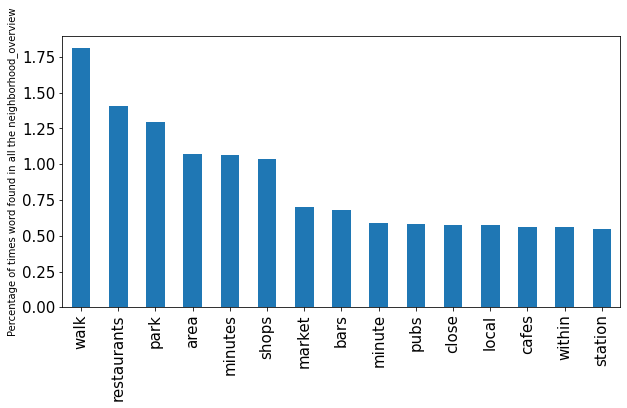

In [ ]:
mtools.bar_plot_quick(twp.head(15), figsize=(10, 5), fontsize=15, vert=True)
plt.ylabel("Percentage of times word found in all the neighborhood_overview")
None

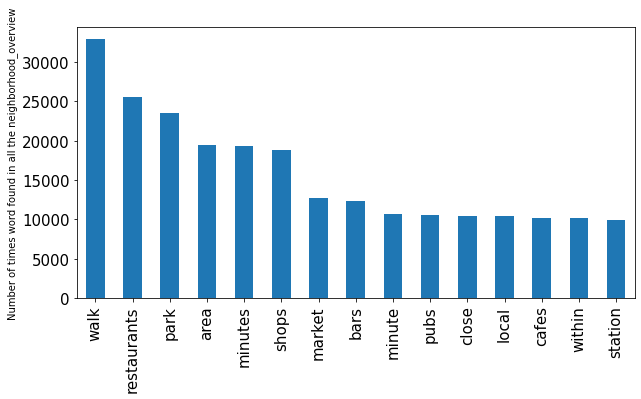

In [ ]:
mtools.bar_plot_quick(tw.head(15), figsize=(10, 5), fontsize=15, vert=True)
plt.ylabel("Number of times word found in all the neighborhood_overview")
None

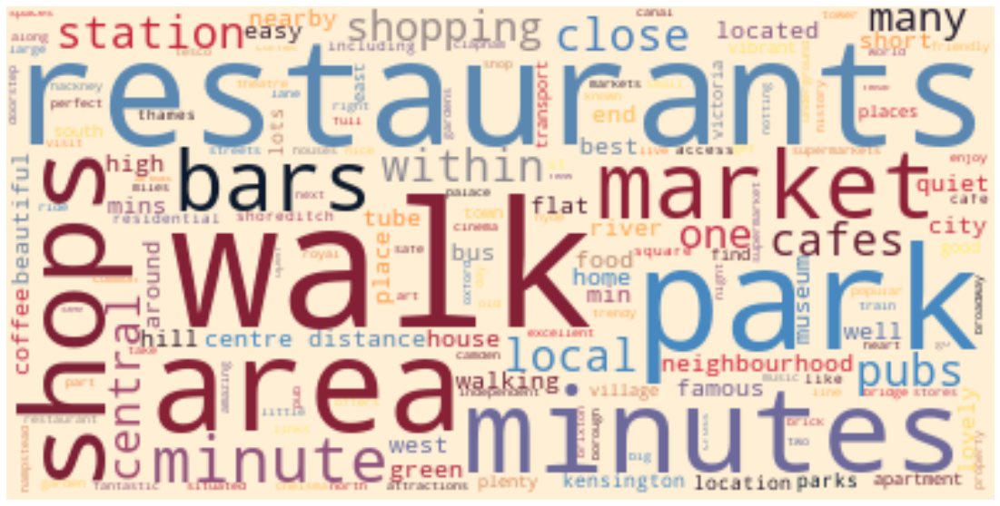

In [ ]:
tw = hero.visualization.wordcloud(df['neigh_clean'])

To have a more graphical representation, it will be used the Principle Component Analysis or PCA to compress the words into vector space. But first we neeed to find the Term Frequency- Inverse Document Frequency that is a numerical statiscs intended to reflect how important a word is to a document in a colection of corpus. In this case each observatio.  

The next is to run a K-means clustering to add color to the graphical representation. Texthero takes a Series as input and Series as output so I can set the output to be a new column in the dataframe.

In [ ]:
df['neigh_clean_tfidf'] = (hero.tfidf(df['neigh_clean'], max_features=100))

In [ ]:
df['neigh_clean_tfidf'].head()

0    [0.0, 0.0, 0.0, 0.2439725997099291, 0.0, 0.0, ...
1    [0.0, 0.4401748711259345, 0.0, 0.0, 0.0, 0.0, ...
2    [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...
3    [0.0, 0.0, 0.0, 0.19745498732077116, 0.0, 0.0,...
4    [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.21022861...
Name: neigh_clean_tfidf, dtype: object

In [ ]:
df['neigh_clean_pca'] = (df['neigh_clean_tfidf'].pipe(hero.pca))

In [ ]:
df['neigh_clean_kmeans_3'] = (df['neigh_clean_tfidf'].pipe(hero.kmeans, n_clusters=3).astype(str))

In [ ]:
df['neigh_clean_kmeans_4'] = (df['neigh_clean_tfidf'].pipe(hero.kmeans, n_clusters=4).astype(str))

In [ ]:
df['neigh_clean_kmeans_5'] = (df['neigh_clean_tfidf'].pipe(hero.kmeans, n_clusters=5).astype(str))

In [ ]:
df['neigh_clean_kmeans_6'] = (df['neigh_clean_tfidf'].pipe(hero.kmeans, n_clusters=5).astype(str))

In [ ]:
df['neigh_clean_kmeans_7'] = (df['neigh_clean_tfidf'].pipe(hero.kmeans, n_clusters=7).astype(str))

In [ ]:
df.head()

,id,description,neighborhood_overview,picture_url,host_id,host_url,host_since,host_location,host_about,host_response_time,host_response_rate,host_acceptance_rate,host_is_superhost,host_neighbourhood,host_listings_count,host_total_listings_count,host_verifications,neighbourhood,neighbourhood_cleansed,latitude,longitude,property_type,room_type,accommodates,bedrooms,beds,amenities,price,minimum_nights,maximum_nights,minimum_minimum_nights,maximum_minimum_nights,minimum_maximum_nights,maximum_maximum_nights,minimum_nights_avg_ntm,maximum_nights_avg_ntm,has_availability,availability_30,availability_60,availability_90,availability_365,number_of_reviews,number_of_reviews_ltm,number_of_reviews_l30d,first_review,last_review,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,instant_bookable,calculated_host_listings_count,calculated_host_listings_count_entire_homes,calculated_host_listings_count_private_rooms,calculated_host_listings_count_shared_rooms,reviews_per_month,bathrooms,bathrooms_shared,number_amenities,amenities_1,wifi,heating,essentials,kitchen,smoke_alarm,washer,hangers,iron,tv,hair_dryer,shampoo,dedicated_workspace,carbon_monoxide_alarm,hot_water,dryer,refrigerator,dishes_and_silverware,cooking_basics,oven,bed_linens,microwave,stove,fire_extinguisher,first_aid_kit,private_entrance,dishwasher,coffee_maker,long_term_stays_allowed,elevator,free_parking_on_premises,extra_pillows_and_blankets,lock_on_bedroom_door,host_greets_you,cable_tv,luggage_dropoff_allowed,patio_or_balcony,garden_or_backyard,breakfast,paid_parking_off_premises,lockbox,free_street_parking,bathtub,room_type_num,months_since_first_reviews,months_with_reviews,months_as_host,host_sice_YYYY,first_review_YYYY,last_review_YYYY,price_log,predicted_price_log_01,predicted_price_01,desc_clean,desc_clean_tfidf,desc_clean_pca,desc_clean_kmeans_5,desc_clean_kmeans_7,desc_clean_kmeans_4,desc_clean_kmeans_3,desc_clean_kmeans_6,desccription_pca_x,desccription_pca_y,neigh_clean,neigh_clean_tfidf,neigh_clean_pca,neigh_clean_kmeans_3,neigh_clean_kmeans_4,neigh_clean_kmeans_5,neigh_clean_kmeans_6,neigh_clean_kmeans_7
0,11551,Unlike most rental apartments out there my fla...,Not even 10 minutes by metro from Victoria Sta...,https://a0.muscache.com/pictures/b7afccf4-18e5...,43039,https://www.airbnb.com/users/show/43039,2009-10-03,"London, England, United Kingdom","Hello, I'm a friendly Italian man with a very ...",within an hour,100.0,90.0,0.0,Brixton,3.0,3.0,"['email', 'phone', 'reviews', 'jumio', 'offlin...","London, United Kingdom",Lambeth,51.46225,-0.11732,Entire apartment,Entire home/apt,4,1.0,3.0,"[""Refrigerator"", ""Kitchen"", ""Crib"", ""Dedicated...",105.0,2,1125,2.0,2.0,1125.0,1125.0,2.0,1125.0,1.0,3,33,63,338,192,6,0,2010-03-21,2020-03-26,91.0,9.0,9.0,10.0,10.0,9.0,9.0,1.0,2,2,0,0,1.46,1.0,0.0,28,"[Refrigerator, Kitchen, Crib, Dedicated worksp...",1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,1.0,1.0,1.0,0.0,1.0,1.0,1.0,1.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1,5.0,120.0,134.0,2009.0,2010.0,2020.0,4.653960,4.345627,77.140373,unlike rental apartments flat gives straight a...,"[0.21304835505930939, 0.0, 0.18263644544879062...","[-0.2070604982596298, -0.0718572616076508]",2,3,1,0,3,-0.207060,-0.071857,even minutes metro victoria station community ...,"[0.0, 0.0, 0.0, 0.2439725997099291, 0.0, 0.0, ...","[0.1157076089881832, -0.06640286080300466]",0,2,0,3,3
1,13913,My bright double bedroom with a large window h...,Finsbury Park is a friendly melting pot commun...,https://a0.muscache.com/pictures/miso/Hosting-...,54730,https://www.airbnb.com/users/show/54730,2009-11-16,"London, England, United Kingdom",I am a Multi-Media Visual Artist and Creative ...,within a few hours,100.0,75.0,0.0,LB of Islington,3.0,3.0,"['email', 'phone', 'facebook', 'reviews', 'off...","Islington, Greater London, United Kingdom",Islingto

In [ ]:
hero.scatterplot(df, 'neigh_clean_pca', color='neigh_clean_kmeans_3', title="3 Clusters of Airbnb Neighbourhood Overview")

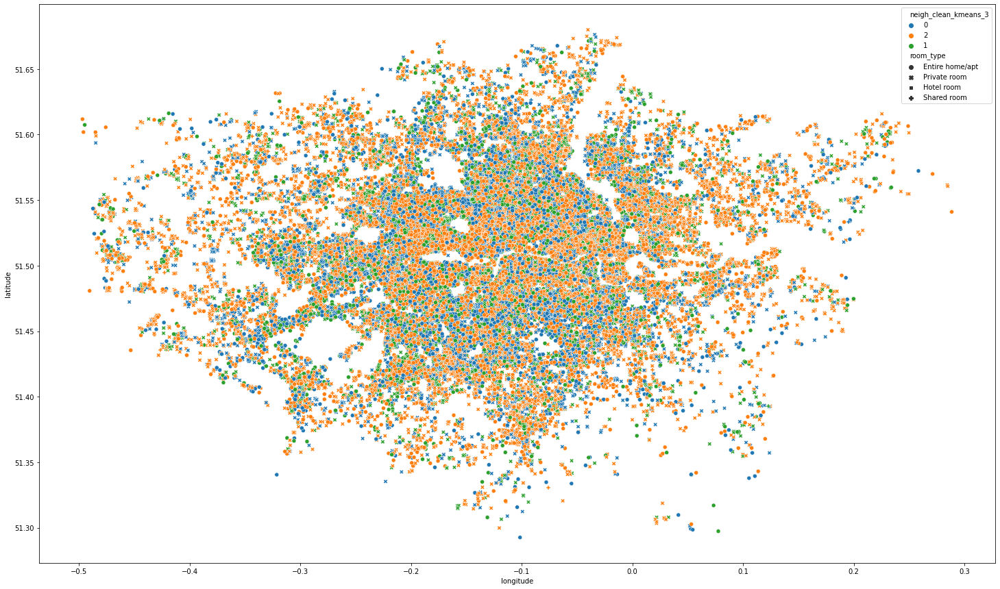

In [ ]:
fig, ax = plt.subplots(figsize=(25, 15))
sns.scatterplot(data=df, x="longitude", 
                y="latitude", 
                hue="neigh_clean_kmeans_3", 
                style="room_type",
                ax=ax)

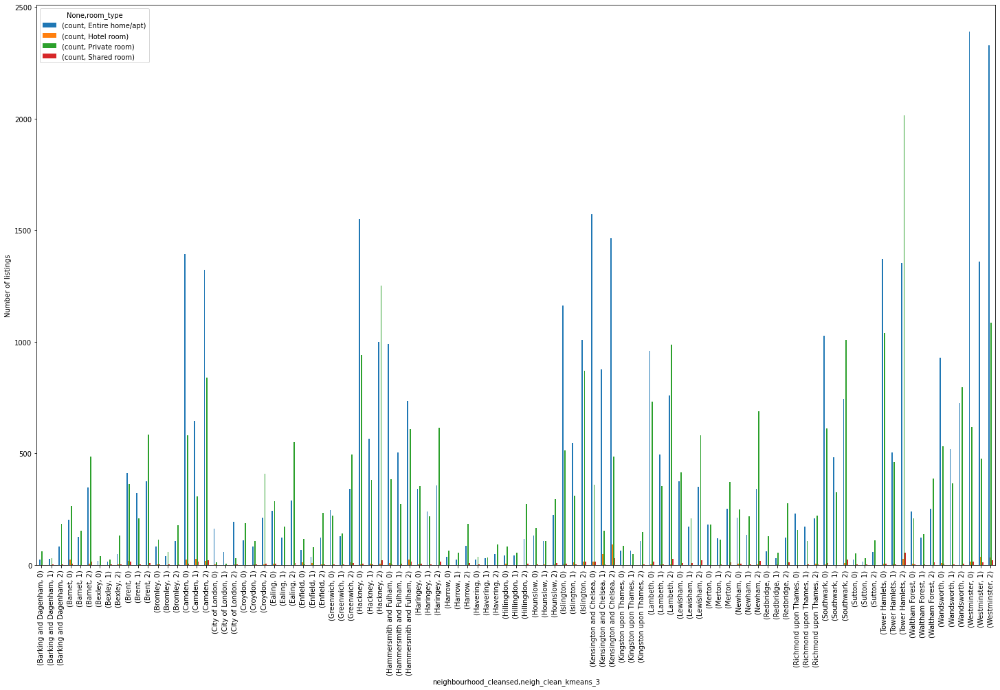

In [ ]:
df_clust_3_details = df.groupby(['neighbourhood_cleansed', 'neigh_clean_kmeans_3', 'room_type'])['desc_clean_kmeans_3'].count().to_frame('count')
fig, ax = plt.subplots(figsize=(25, 15))
df_clust_3_details.unstack().plot(kind='bar', ax=ax)
plt.ylabel('Number of listings')
plt.xticks(rotation=90)
None

In [ ]:
df_clust_3_details_unst = df_clust_3_details.unstack().reset_index()

In [ ]:
df_clust_3_details_unst_c2 = df_clust_3_details_unst[df_clust_3_details_unst['neigh_clean_kmeans_3'].isin(['2'])]

In [ ]:
df_clust_3_details_unst_c2.set_index('neighbourhood_cleansed', inplace=True)

In [ ]:
del df_clust_3_details_unst_c2['neigh_clean_kmeans_3']

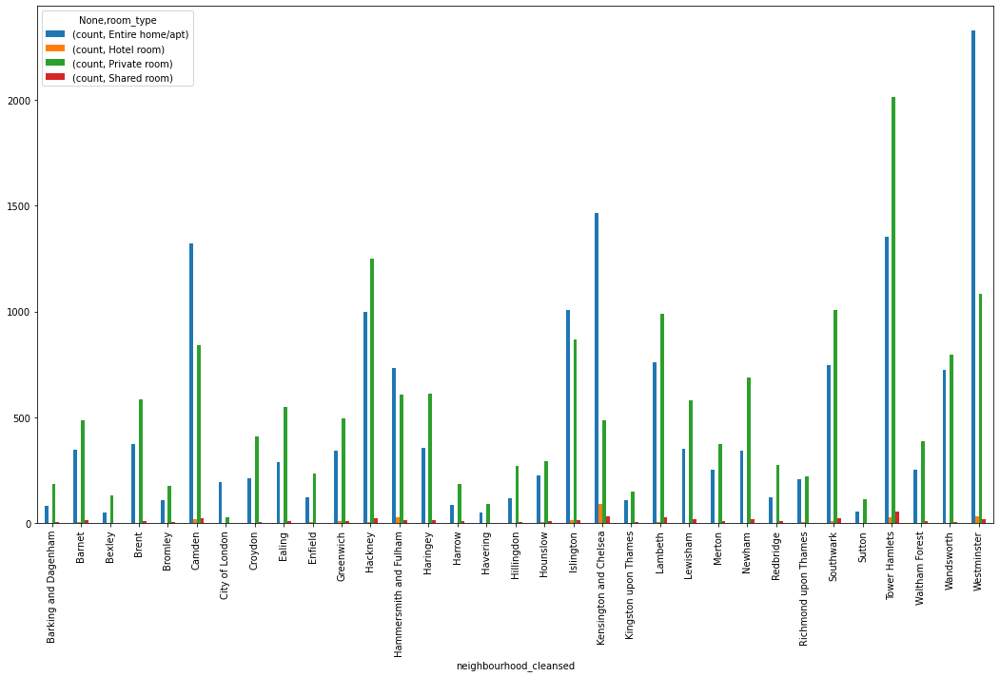

In [ ]:
fig, ax = plt.subplots(figsize=(18, 10))
df_clust_3_details_unst_c2.plot(kind='bar', ax=ax)

In [ ]:
df_clust_3_details_unst.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 99 entries, 0 to 98
Data columns (total 6 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   (neighbourhood_cleansed, )  99 non-null     object 
 1   (neigh_clean_kmeans_3, )    99 non-null     object 
 2   (count, Entire home/apt)    99 non-null     float64
 3   (count, Hotel room)         49 non-null     float64
 4   (count, Private room)       99 non-null     float64
 5   (count, Shared room)        76 non-null     float64
dtypes: float64(4), object(2)
memory usage: 4.8+ KB


In [ ]:
df_clust_3_details_03 = df.groupby(['neigh_clean_kmeans_3', 'room_type'])['neigh_clean_kmeans_3'].count().to_frame('count')

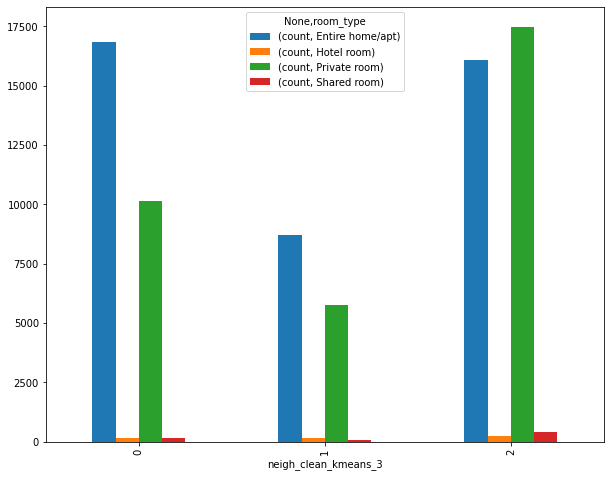

In [ ]:
fig, ax = plt.subplots(figsize=(10, 8))
df_clust_3_details_03.unstack().plot(kind='bar', ax=ax)
plt.xticks(rotation=90)
None

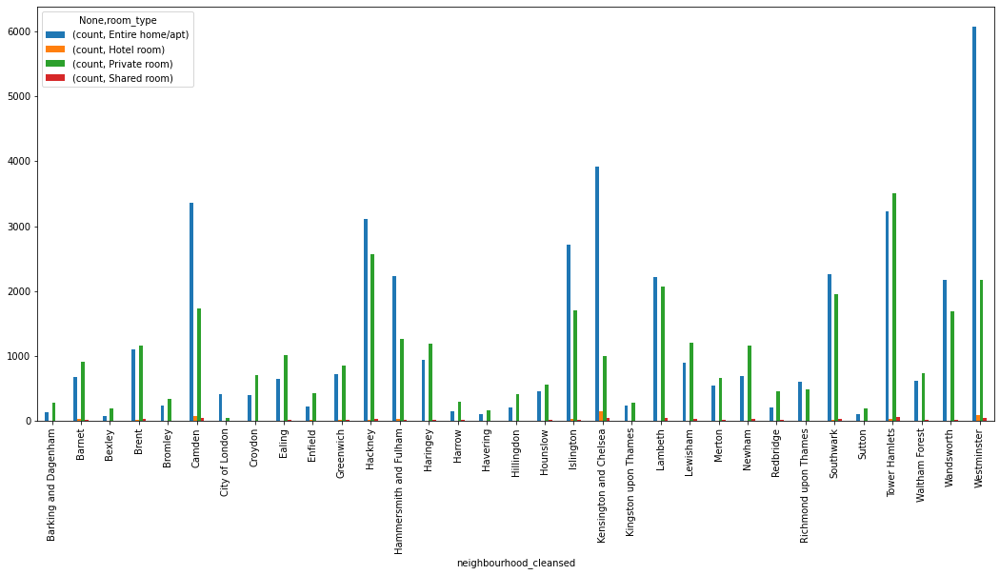

In [ ]:
fig, ax = plt.subplots(figsize=(18, 8))
df.groupby(['neighbourhood_cleansed', 'room_type'])['neigh_clean_kmeans_3'].count().to_frame('count').unstack().plot(kind='bar', ax=ax)
plt.xticks(rotation=90)
None

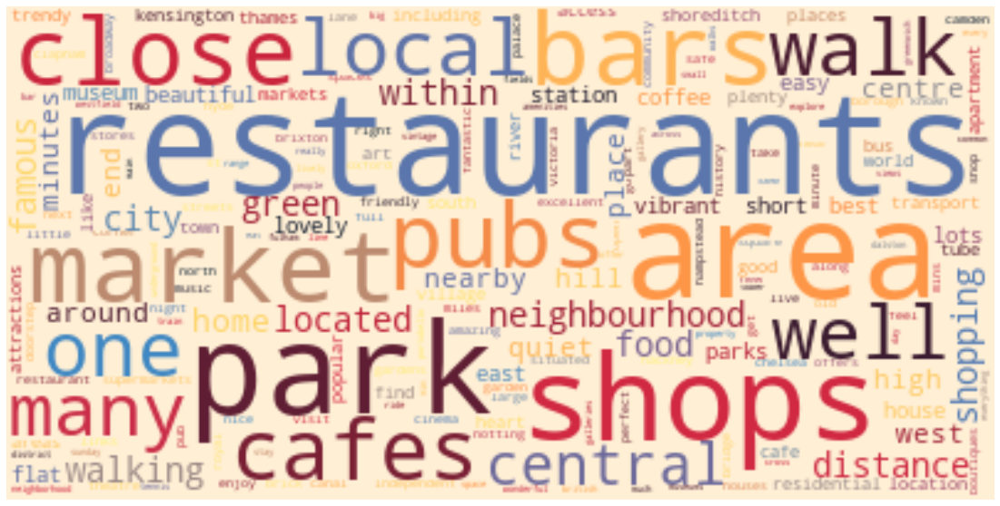

In [ ]:
tw_3_2 = hero.visualization.wordcloud(df.loc[df['neigh_clean_kmeans_3'].isin(['0']), 'neigh_clean'])

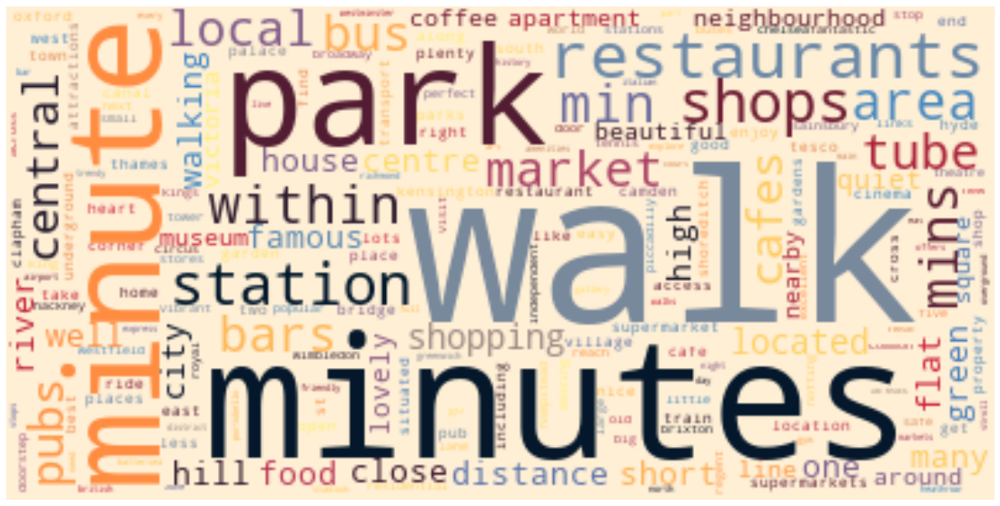

In [ ]:
tw_3_2 = hero.visualization.wordcloud(df.loc[df['neigh_clean_kmeans_3'].isin(['1']), 'neigh_clean'])

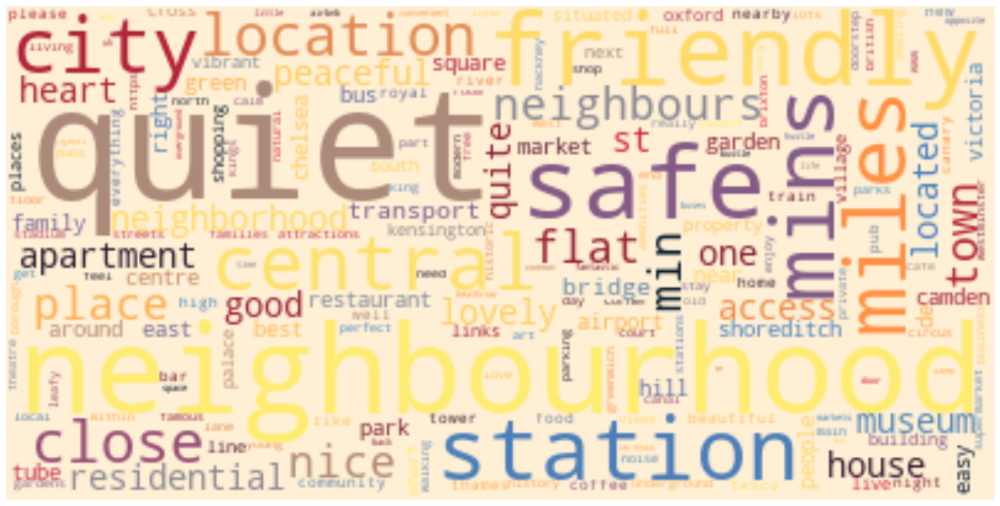

In [ ]:
tw_3_3 = hero.visualization.wordcloud(df.loc[df['neigh_clean_kmeans_3'].isin(['2']), 'neigh_clean'])

In [ ]:
hero.scatterplot(df, 'neigh_clean_pca', color='neigh_clean_kmeans_4', title="4 Clusters of Neighboardhood Overview")

In [ ]:
hero.scatterplot(df, 'neigh_clean_pca', color='neigh_clean_kmeans_5', title="5 Clusters of Neighboardhood Overview")

In [ ]:
hero.scatterplot(df, 'neigh_clean_pca', color='neigh_clean_kmeans_6', title="6 Clusters of Airbnb Neighboardhood Overview")

In [ ]:
hero.scatterplot(df, 'neigh_clean_pca', color='neigh_clean_kmeans_7', title="5 Clusters of Airbnb Neighboardhood Overview")

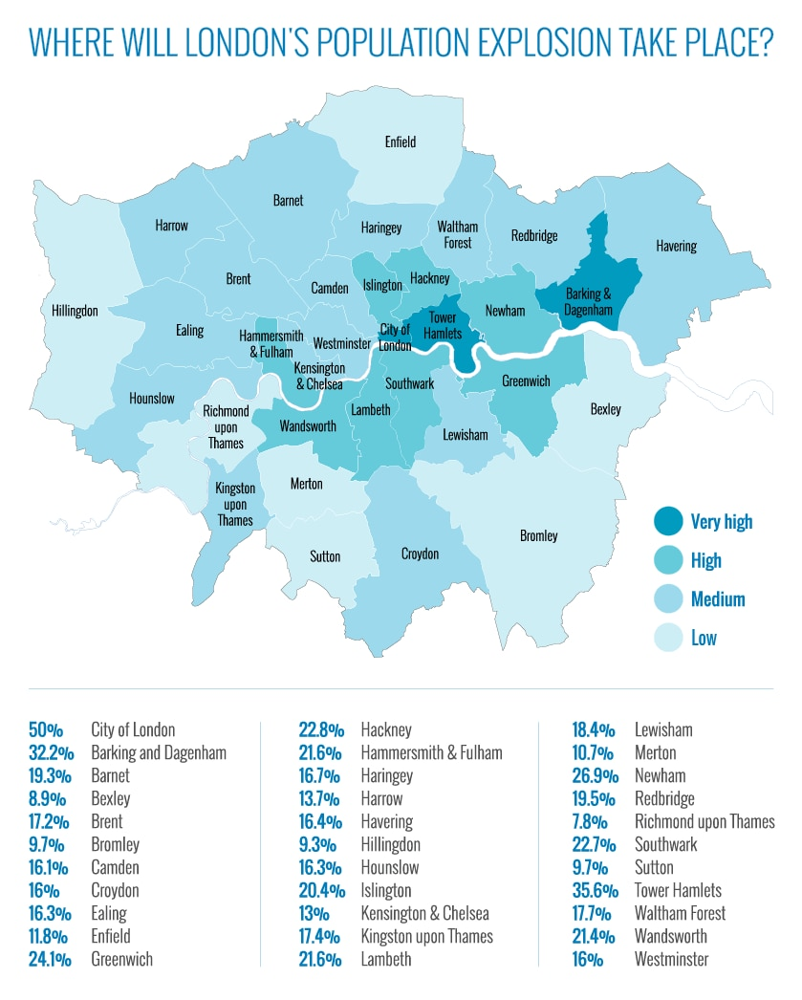

In [ ]:
display.Image("https://www.cityam.com/assets/uploads/content/2016/09/150203-london-boroughs-57edad1271160.png")

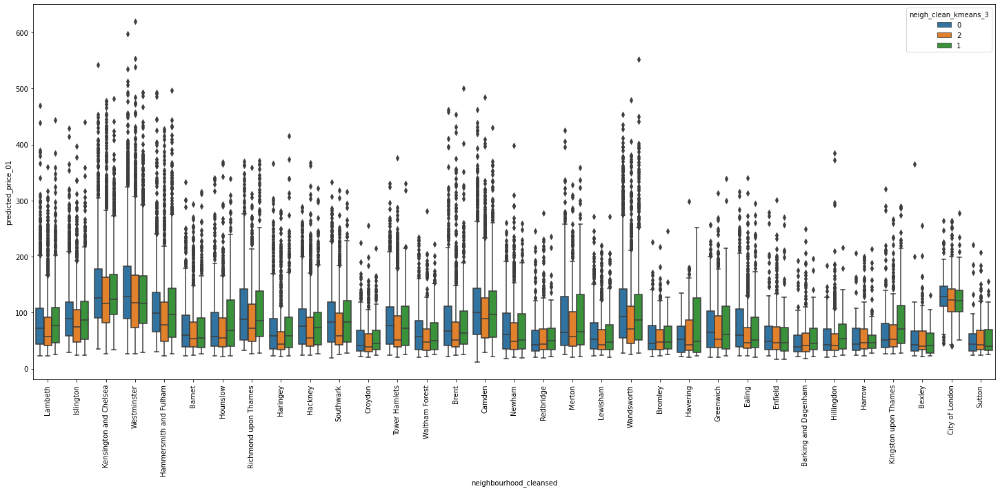

In [ ]:
fig, ax = plt.subplots(figsize=(25, 10))
sns.boxplot(x="neighbourhood_cleansed", y="predicted_price_01", hue='neigh_clean_kmeans_3', data=df)
plt.xticks(rotation=90)
None

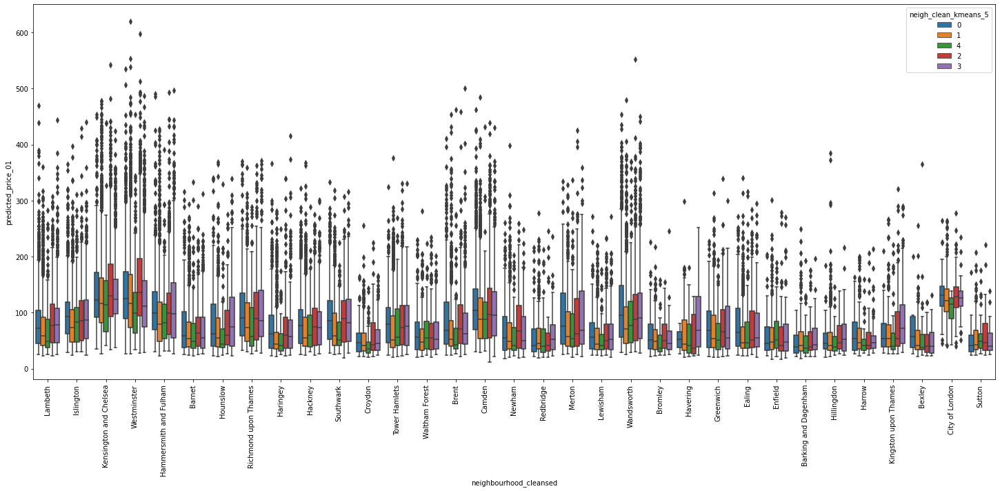

In [ ]:
fig, ax = plt.subplots(figsize=(25, 10))
sns.boxplot(x="neighbourhood_cleansed", y="predicted_price_01", hue='neigh_clean_kmeans_5', data=df)
plt.xticks(rotation=90)
None

In [ ]:
# PCA representation of description
df['neighborhood_overview_pca_x'] = df['neigh_clean_pca'].apply(lambda x: x[0])
df['neighborhood_overview_pca_y'] = df['neigh_clean_pca'].apply(lambda x: x[1]) 

In [ ]:
# df.to_pickle('extended_data_set_pred_01_pca.pick')